In [1]:
using Pkg
using Formatting, Plots, LaTeXStrings, Measures
Pkg.activate("/home/julisn/Codes/MFDecoupling.jl")
using MFDecoupling
using JLD2, DataFrames

  Activating project at `~/Codes/MFDecoupling.jl`


In [292]:
fn_pt = "/home/julisn/Hamburg/Projects/MFDecoupling/data/out_pt1.jld2"
fn_coarse = "/home/julisn/Hamburg/Projects/MFDecoupling/data/out_coarse.jld2"
fn_smallU = "/home/julisn/Hamburg/Projects/MFDecoupling/data/out_smallU.jld2"
dfFile = "/home/julisn/Hamburg/Projects/MFDecoupling/data/U01V05_df.jld2"
Uin = 0.1
Vin = 0.8888888888888888 #0.5 ##0.6666666666666666 #0.5;

0.8888888888888888

In [293]:
using Statistics, FourierAnalysis, Images


function find_lim(tx, signal; lim_tx_start=tx[end-100])
    lim_ind=searchsortedfirst(tx, 450.0)
    return lim = mean(signal[lim_ind:end])
end

"""
     find_amplitude(tx, signal)

WARNING: THIS ONLY WORKS FOR SIGNALS WITH ONLY ONE FREQUENCY!! (check against find_amplitude_min)
Estimation of amplitude, using local maxima/minima and linear interpolation.
Returns two arrays: `tx` (times of amplitudes) and `ampl` (amplitude).
"""
function find_amplitude(tx, signal)
    maxy_ix = findlocalmaxima(signal)
    miny_ix = findlocalminima(signal)
    if length(maxy_ix) != 0
        start = tx[miny_ix[1]] <  tx[maxy_ix[1]] ? 0 : 1
        ind = 2:length(maxy_ix)-2
        ampl = Vector{Float64}(undef, length(ind))
        for (i,ii) in enumerate(ind)
            ampl[i] = mean(signal[maxy_ix[ii-1:ii]]) - signal[miny_ix[ii-start]]
        end
        return length(ampl) != 0 ? ampl : [0.0]
    else
        return [0.0]
    end
end

function find_amplitude_lim(tx::AbstractVector, signal::AbstractVector; lim_tx_start=tx[end-100])
    lim_ind=searchsortedfirst(tx, 400.0)
    ampl_lim = maximum(signal[lim_ind:end]) - minimum(signal[lim_ind:end])
    return ampl_lim
end

"""
    find_lim_max(tx::AbstractVector, signal::AbstractVector)

maximum amplitude at time tx.
tx is reversed (!!).
"""
function find_ampl_lim_max(tx::AbstractVector, signal::AbstractVector, lim::Float64)
    max_list = Float64[abs((last(signal) - lim))/lim]
    max_tx_list = Float64[last(tx)]
    
    for i in length(signal)-1:-1:1
        ampl_new = abs((signal[i] - lim)/lim)
        #println(ampl_new, " vs ", last(max_list))
        if  ampl_new > last(max_list)
            push!(max_list, ampl_new)
            push!(max_tx_list, tx[i])
        end
    end
    return max_tx_list, max_list
end

function eq_time(tx, signal; delta=1e-7, lim_tx_start=450.0)
    lim = find_lim(tx, signal)
    tx_ampl, lim_ampl = find_ampl_lim_max(tx, signal, lim)
    res_i = searchsortedfirst(lim_ampl, delta)
    res =  res_i > length(tx_ampl) ? tx[end] : tx_ampl[res_i]
    return res
end


function eq_time_old(tx, signal; delta=1e-7, lim_tx_start=450.0)
    maxy_ix = findlocalmaxima(signal)
    miny_ix = findlocalminima(signal)
    lim = find_lim(tx, signal, lim_tx_start=lim_tx_start)
    if length(maxy_ix) != 0
        start = tx[miny_ix[1]] <  tx[maxy_ix[1]] ? 0 : 1
        ind = 2:length(maxy_ix)-2
        for (i,ii) in enumerate(ind)
            if abs(mean(signal[maxy_ix[ii-1:ii]]) - lim) < delta && abs(signal[miny_ix[ii-start]] - lim) < delta
                return tx[miny_ix[ii-start]]
            end
        end
    end
    return tx[end]
end


function build_df(fn::String)
    df = DataFrame(U = Float64[], V = Float64[], t = Vector{Float64}[],        rho11 = Vector{ComplexF64}[], rho12 = Vector{ComplexF64}[],
                   rho13 = Vector{ComplexF64}[], rho14 = Vector{ComplexF64}[], rho22 = Vector{ComplexF64}[], rho23 = Vector{ComplexF64}[],
                   rho24 = Vector{ComplexF64}[], rho33= Vector{ComplexF64}[],  rho34 = Vector{ComplexF64}[], rho44 = Vector{ComplexF64}[], C01 = Vector{ComplexF64}[])
    if isfile(fn)
        rU, rV, rT, rS = jldopen(fn,"r") do ft
            ft["U"], ft["V"], ft["t"], ft["solution"]
        end
        for i in 1:length(rU)
            row = [rU[i], rV[i], rT, eachslice(rS[:,:,i],dims=1)...]
            push!(df,row)
        end
    elseif isdir(fn)
        fl = readdir(fn, join=true)
        filter!(x-> endswith(x,"jld2"), fl)
        for fi in fl
            rU, rV, rT, rS = jldopen(fi,"r") do fii
                tmp = keys(fii)[1]
                #V = haskey(fii["$tmp"], "V") ? fii["$tmp/V"] : NaN
                if haskey(fii, "U")
                    fii["U"], fii["V"], fii["t"], fii["sol"]
                else
                    fii["$tmp/U"], NaN, fii["$tmp/t"], fii["$tmp/sol"]
                end
            end
            row = [rU, rV, rT, eachslice(rS,dims=1)...]
            push!(df,row)
        end
    else
        error("$fn is not a result file or directory!")
    end
    df[!,:f_up] = df[:,:rho13] .+ df[:,:rho24]
    df[!,:f_do] = df[:,:rho12] .+ df[:,:rho34]
    
    # supplement mean value
    lim_ind = 300
    
    for cn in names(df)[4:end]
        df[!,Symbol(cn * "_lim")] = map(x->find_lim(x.t, x[cn]), eachrow(df[:,[:t, Symbol(cn)]]))
    end

    ampl_cols = ["rho11", "f_up", "C01"]
    for cn in ampl_cols
        #TODO: fix this, this creates Vector{Tuple{Vector,Vector}} instead of Tuple{Vector,Vectors}
        df[!,Symbol(cn * "_eq_time_1e_2")] = map(x->eq_time(x.t, real(x[cn]); delta=1e-2, lim_tx_start=450.0), eachrow(df[:,[:t, Symbol(cn)]]))
        df[!,Symbol(cn * "_eq_time_1e_6")] = map(x->eq_time(x.t, real(x[cn]); delta=1e-6, lim_tx_start=450.0), eachrow(df[:,[:t, Symbol(cn)]]))
        df[!,Symbol(cn * "_ampl")] = map(x->find_amplitude(x.t, real(x[cn])), eachrow(df[:,[:t, Symbol(cn)]]))
        df[!,Symbol(cn * "_ampl_tx")] = map(x->x.t[findlocalminima(real(x[cn]))], eachrow(df[:,[:t, Symbol(cn)]]))
        df[!,Symbol(cn * "_ampl_asym")] = map(x->find_amplitude_lim(x.t, real(x[cn])), eachrow(df[:,[:t, Symbol(cn)]]))
        #df[!,Symbol(cn * "_ampl_tf")] = map(x-> (x[1][1][end],x[1][2][end]), eachrow(df[!,Symbol(cn * "_ampl")]))
    end
    
    # calculate ffts of time series
    fft_cols = ["rho11", "rho12", "rho22", "rho24", "f_up", "C01"]
    fft_start_i = trunc(Int, length(df[1,:t]) / 10)
    tx_fft = df[1,:t][fft_start_i:end]
    freqs = collect(FourierAnalysis.fftfreq(length(tx_fft), 1.0/diff(tx_fft)[1]) |> FourierAnalysis.fftshift)
    df[!,:freqs] = [freqs for i in 1:size(df,1)]
    for cl in fft_cols
        df[!,Symbol(cl * "_fft")] = map(x-> FourierAnalysis.fft(x[1][fft_start_i:end] .- x[2]) ./ length(x[1]) |> FourierAnalysis.fftshift, eachrow(df[:,[Symbol(cl),Symbol(cl * "_lim")]]))
        df[!,Symbol(cl * "_fft_zm")] = map(x-> FourierAnalysis.fft(x[fft_start_i:end]) ./ length(x[fft_start_i:end]) |> FourierAnalysis.fftshift, df[:,Symbol(cl)])
    end

    return df
end

df = if false && isfile(dfFile)
    jldopen(dfFile) do ff
        ff["df"]
    end
else
    df_pt = build_df(fn_pt);
    df_coarse = build_df(fn_coarse);
    df_smallU = build_df(fn_smallU);
    
    # combine and remove duplicates
    df = combine(groupby(vcat(df_pt,df_smallU,df_coarse), [:U, :V]), last); 
    jldopen(dfFile, "w") do ff
        ff["df"] = df
    end
end

df_Vin = df[df.V .≈ Vin, :]
sort!(df_Vin, [:U])
VList = sort(unique(df.V));

# Investigation at V = V_in

- physical meaning of rho diagonal and off-diagonal

- No decay for U < U_in (THIS CONTRADICTS PAPER!!!)
- Constant at U = U_in (equilibrium solution)
- decay for U_in < U < U_c
- ??? U > U_c

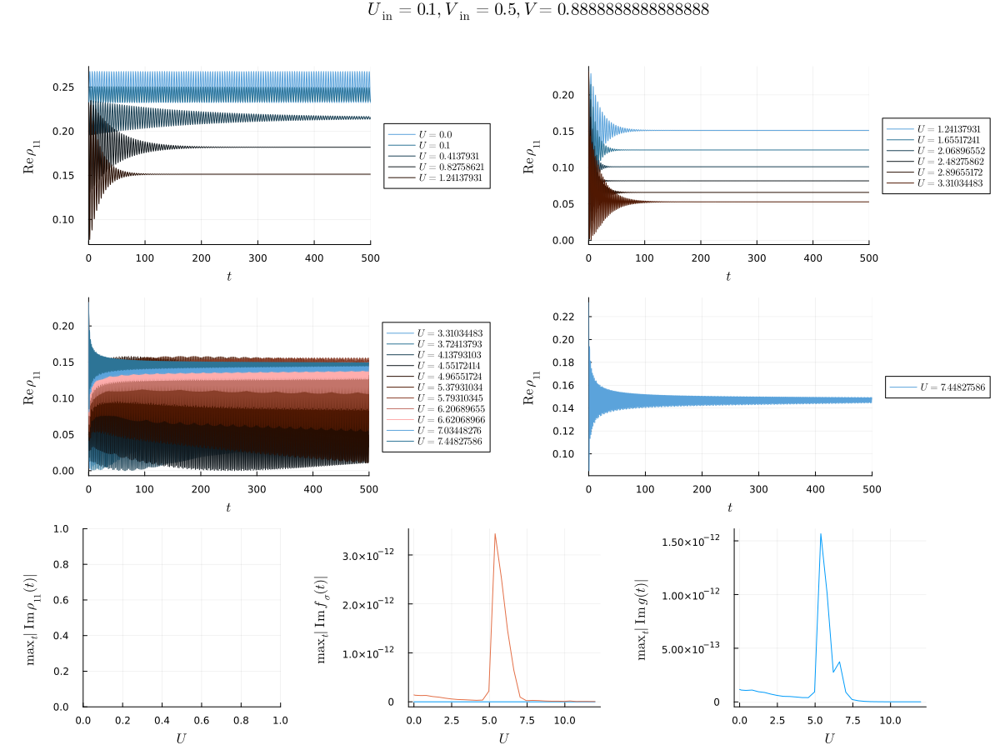

In [297]:
UList_Vin = sort(unique(df_Vin.U))
pa = plot(title=L"U_\mathrm{in}=%$Uin,V_\mathrm{in}=0.5,V=%$Vin", grid=false,showaxis=false,bottom_margn=-0mm)
p0 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, \rho_{11}",xlims=(0,500))
p1 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, \rho_{11}",xlims=(0,500))
p2 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, \rho_{11}",xlims=(0,500))
p3 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, \rho_{11}",xlims=(0,500))
p4 = plot(legend=nothing, xlabel=L"U", ylabel=L"\max_t | \mathrm{Im}\,\rho_{11} (t)|")
p5 = plot(legend=nothing, xlabel=L"U", ylabel=L"\max_t | \mathrm{Im}\,f_\sigma (t)|") 
p6 = plot(legend=nothing, xlabel=L"U", ylabel=L"\max_t | \mathrm{Im}\,g(t)|")
for Ui in UList_Vin[1:1:5]
    plot!(p0, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:rho11]), label=L"U=%$(round(Ui,digits=8))")
end

for Ui in UList_Vin[5:10]
    plot!(p1, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:rho11]), label=L"U=%$(round(Ui,digits=8))")
end
for Ui in UList_Vin[10:20]
    plot!(p2, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:rho11]), label=L"U=%$(round(Ui,digits=8))")
end
for Ui in UList_Vin[20:15:end]
    plot!(p3, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:rho11]), label=L"U=%$(round(Ui,digits=8))")
end

plot!(p5, df_Vin.U, map(x -> maximum(abs.(imag(x))), df_Vin[:,:rho11]))
plot!(p5, df_Vin.U, map(x -> maximum(abs.(imag(x))), df_Vin[:,:f_up]))
plot!(p6, df_Vin.U, map(x -> maximum(abs.(imag(x))), df_Vin[:,:C01]))

l = @layout [
    tt{1.0w, 0.001h}
    a{0.5w} b{0.5w} 
    c{0.5w} d{0.5w} 
    e{0.3w} f{0.3w}  g{0.3w}
    ]
plot(pa, p0, p1, p2, p3, p4, p5, p6, layout=l, size=(1200,900), left_margin=10mm)

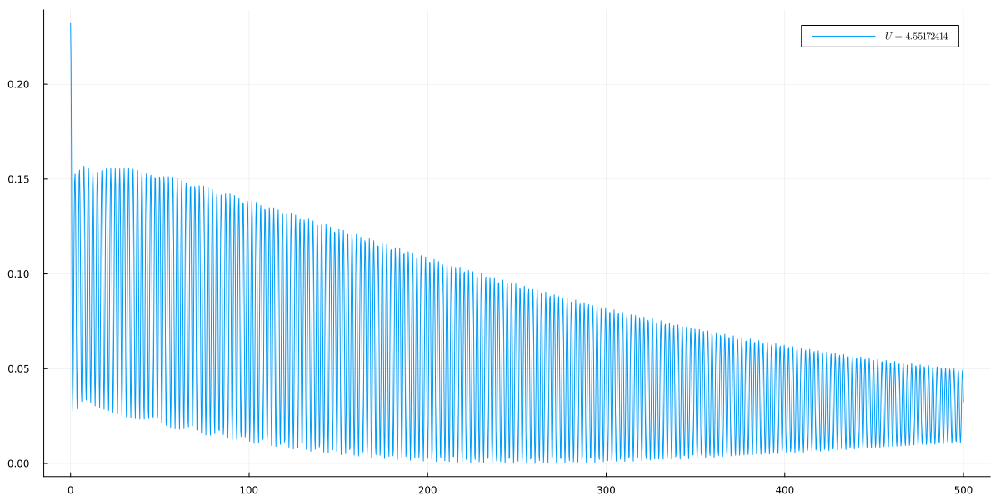

In [319]:
 Ui = sort(UList_Vin)[13]
    plot( df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:rho11]), size=(1200,600),label=L"U=%$(round(Ui,digits=8))")


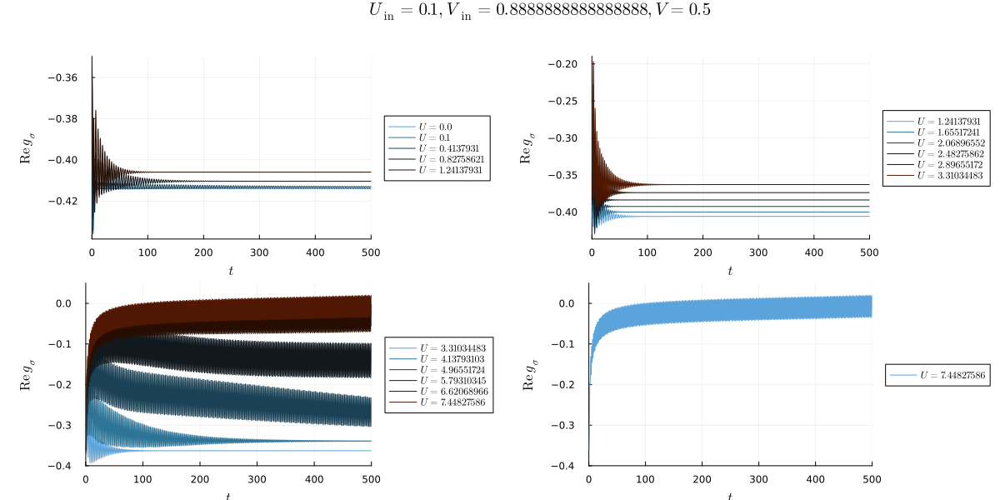

In [295]:
UList_Vin = sort(unique(df_Vin.U))
pa = plot(title=L"U_\mathrm{in}=%$Uin,V_\mathrm{in}=%$Vin,V=0.5", grid=false,showaxis=false,bottom_margn=-0mm)
p0 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, g_\sigma",xlims=(0,500))
p1 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, g_\sigma",xlims=(0,500))
p2 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, g_\sigma",xlims=(0,500), ylims=(-0.4,0.05))
p3 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, g_\sigma",xlims=(0,500), ylims=(-0.4,0.05))
for Ui in UList_Vin[1:1:5]
    plot!(p0, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:C01]), label=L"U=%$(round(Ui,digits=8))")
end

for Ui in UList_Vin[5:10]
    plot!(p1, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:C01]), label=L"U=%$(round(Ui,digits=8))")
end
for Ui in UList_Vin[10:2:20]
    plot!(p2, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:C01]), label=L"U=%$(round(Ui,digits=8))")
end
for Ui in UList_Vin[20:20:end]
    plot!(p3, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:C01]), label=L"U=%$(round(Ui,digits=8))")
end
l = @layout [
    tt{1.0w, 0.001h}
    a{0.5w} b{0.5w} 
    c{0.5w} d{0.5w} 
    ]
plot(pa, p0, p1, p2, p3, layout=l, size=(1200,600), left_margin=10mm)

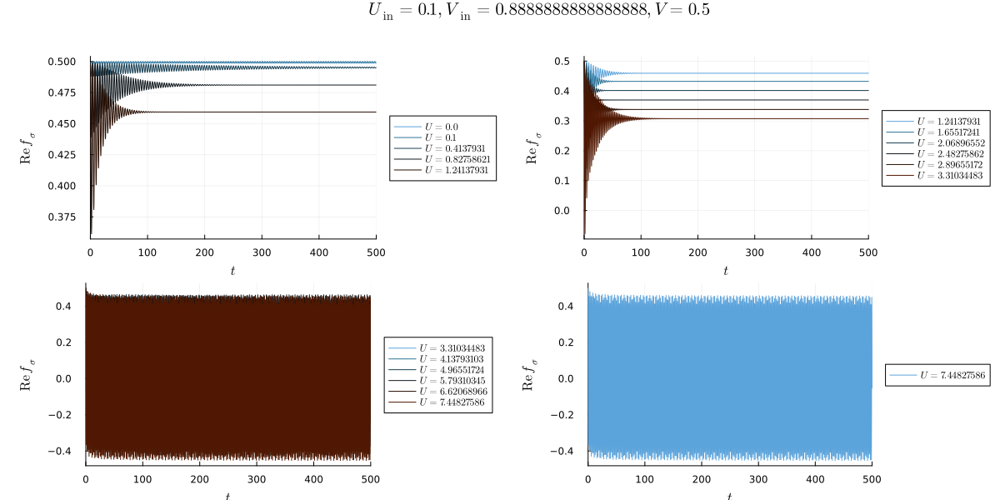

In [296]:
UList_Vin = sort(unique(df_Vin.U))
pa = plot(title=L"U_\mathrm{in}=%$Uin,V_\mathrm{in}=%$Vin,V=0.5", grid=false,showaxis=false,bottom_margn=-0mm)
p0 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, f_\sigma",xlims=(0,500))
p1 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, f_\sigma",xlims=(0,500))
p2 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, f_\sigma",xlims=(0,500))
p3 = plot(legend=:outerright,palette=:berlin10, xlabel=L"t", ylabel=L"\mathrm{Re}\, f_\sigma",xlims=(0,500))
for Ui in UList_Vin[1:1:5]
    plot!(p0, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:f_up]), label=L"U=%$(round(Ui,digits=8))")
end

for Ui in UList_Vin[5:10]
    plot!(p1, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:f_up]), label=L"U=%$(round(Ui,digits=8))")
end
for Ui in UList_Vin[10:2:20]
    plot!(p2, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:f_up]), label=L"U=%$(round(Ui,digits=8))")
end
for Ui in UList_Vin[20:20:end]
    plot!(p3, df_Vin[df_Vin.U .≈ Ui,:t], real.(df_Vin[df_Vin.U .≈ Ui,:f_up]), label=L"U=%$(round(Ui,digits=8))")
end
l = @layout [
    tt{1.0w, 0.001h}
    a{0.5w} b{0.5w} 
    c{0.5w} d{0.5w} 
    ]
plot(pa, p0, p1, p2, p3, layout=l, size=(1200,600), left_margin=10mm)

L"$U_\mathrm{C} = 3.6741573033707864$"

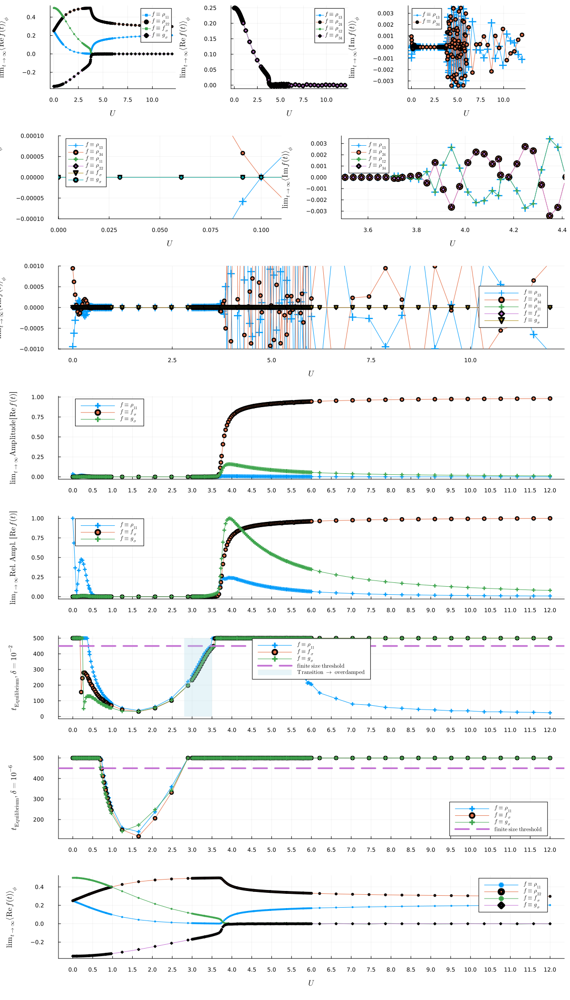

In [289]:
Ux = df_Vin.U
U_c_i = argmin(real(df_Vin.rho11_lim))
U_c = Ux[U_c_i]
U_in_i = findfirst(x->x≈Uin,Ux)
display(L"U_\mathrm{C} = %$(U_c)")

#p0 = plot(legend=:outerright,palette=:berlin10, title=L"U_\mathrm{in}=0.1,V_\mathrm{in}=0.5,V=0.5", xlabel=L"t", ylabel=L"\Re \rho_{11}",xlims=(50,500))
#p1 = plot(legend=:outerright,palette=:berlin10, title=L"U_\mathrm{in}=0.1,V_\mathrm{in}=0.5,V=0.5", xlabel=L"t", ylabel=L"\Re \rho_{11}",xlims=(50,500))

                    
p2 = plot(Ux, real(df_Vin.rho11_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty} \langle \mathrm{Re}\, f(t) \rangle_{\phi}",legend=:topright, markershape=:auto, label=L"f \equiv \rho_{11}", markersize=2)
plot!(Ux, real(df_Vin.rho22_lim), label=L"f \equiv \rho_{22}",  markershape=:auto, markersize=2)
plot!(Ux, real(df_Vin.f_up_lim), label=L"f \equiv f_{\sigma}",  markershape=:auto, markersize=2)
plot!(Ux, real(df_Vin.C01_lim), label=L"f \equiv g_{\sigma}",  markershape=:auto, markersize=2)
p3 = plot(Ux, real(df_Vin.rho13_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty}  \langle \mathrm{Re}\,f(t)\rangle_{\phi}",legend=:topright, markershape=:auto, label=L"f \equiv \rho_{13}")
plot!(Ux, real(df_Vin.rho24_lim), label=L"f \equiv \rho_{24}",  markershape=:auto)
plot!(Ux, real(df_Vin.rho12_lim), label=L"f \equiv \rho_{12}",  markershape=:auto)
plot!(Ux, real(df_Vin.rho34_lim), label=L"f \equiv \rho_{34}",  markershape=:auto)
p4 = plot(Ux, imag(df_Vin.rho13_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty} \langle \mathrm{Im}\, f(t)\rangle_{\phi}",legend=:topleft, markershape=:auto, label=L"f \equiv \rho_{13}", markersize=8)
#plot!(Ux, imag(df_Vin.rho24_lim), label=L"f \equiv \rho_{24}",  markershape=:auto, markersize=7)
#plot!(Ux, imag(df_Vin.rho12_lim), label=L"f \equiv \rho_{12}",  markershape=:auto)
plot!(Ux, imag(df_Vin.rho34_lim), label=L"f \equiv \rho_{34}",  markershape=:auto)

p5 = plot(Ux, imag(df_Vin.rho13_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty} \langle \mathrm{Im}\, f(t)\rangle_{\phi}",legend=:topleft, markershape=:auto, label=L"f \equiv \rho_{13}", markersize=8, xlims=(0.0,0.11), ylims=(-1e-4,1e-4))
#plot!(Ux, imag(df_Vin.rho24_lim), label=L"f \equiv \rho_{24}",  markershape=:auto, markersize=7)
#plot!(Ux, imag(df_Vin.rho12_lim), label=L"f \equiv \rho_{12}",  markershape=:auto)
plot!(Ux, imag(df_Vin.rho34_lim), label=L"f \equiv \rho_{34}",  markershape=:auto)
plot!(Ux, imag(df_Vin.rho11_lim), label=L"f \equiv \rho_{11}", markershape=:auto)
plot!(Ux, imag(df_Vin.rho22_lim), label=L"f \equiv \rho_{22}",  markershape=:auto)
plot!(Ux, imag(df_Vin.f_up_lim), label=L"f \equiv f_{\sigma}",  markershape=:auto)
plot!(Ux, imag(df_Vin.C01_lim), label=L"f \equiv g_{\sigma}",  markershape=:auto)

p6 = plot(Ux, imag(df_Vin.rho13_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty} \langle \mathrm{Im}\, f(t)\rangle_{\phi}",legend=:topleft, markershape=:auto, label=L"f \equiv \rho_{13}", markersize=8, xlims=(U_c - U_c/20, U_c + U_c/5))
plot!(Ux, imag(df_Vin.rho24_lim), label=L"f \equiv \rho_{24}",  markershape=:auto, markersize=7)
plot!(Ux, imag(df_Vin.rho12_lim), label=L"f \equiv \rho_{12}",  markershape=:auto)
plot!(Ux, imag(df_Vin.rho34_lim), label=L"f \equiv \rho_{34}",  markershape=:auto)

p7 = plot(Ux, imag(df_Vin.rho13_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty} \langle \mathrm{Im}\, f(t)\rangle_{\phi}",legend=:right, markershape=:auto, label=L"f \equiv \rho_{13}", markersize=8, ylims=(-1e-3,1e-3))
#plot!(Ux, imag(df_Vin.rho24_lim), label=L"f \equiv \rho_{24}",  markershape=:auto, markersize=7)
#plot!(Ux, imag(df_Vin.rho12_lim), label=L"f \equiv \rho_{12}",  markershape=:auto)
plot!(Ux, imag(df_Vin.rho34_lim), label=L"f \equiv \rho_{34}",  markershape=:auto)
plot!(Ux, imag(df_Vin.rho11_lim), label=L"f \equiv \rho_{11}", markershape=:auto)
#plot!(Ux, imag(df_Vin.rho22_lim), label=L"f \equiv \rho_{22}",  markershape=:auto)
plot!(Ux, imag(df_Vin.f_up_lim), label=L"f \equiv f_{\sigma}",  markershape=:auto)
plot!(Ux, imag(df_Vin.C01_lim), label=L"f \equiv g_{\sigma}",  markershape=:auto)

Ux_ticks = 0:2:12.0
p8 = plot(Ux, df_Vin.rho11_ampl_asym, markershape=:auto, ylabel=L"\lim_{t \to \infty} \mathrm{Amplitude}\, [\mathrm{Re}\, f(t)]", xticks=0:0.5:12, 
        label=L"f \equiv \rho_{11}")
plot!(Ux, df_Vin.f_up_ampl_asym, markershape=:auto, label=L"f \equiv f_{\sigma}")
plot!(Ux, df_Vin.C01_ampl_asym, markershape=:auto,label= L"f \equiv g_{\sigma}")

p9 = plot(Ux, df_Vin.rho11_ampl_asym ./ maximum(df_Vin.rho11_ampl_asym), markershape=:auto, ylabel=L"\lim_{t \to \infty} \mathrm{Rel.Ampl.}\, [\mathrm{Re}\, f(t)]", xticks=0:0.5:12, 
        label=L"f \equiv \rho_{11}")
plot!(Ux, df_Vin.f_up_ampl_asym ./ maximum(df_Vin.f_up_ampl_asym), markershape=:auto, label=L"f \equiv f_{\sigma}")
plot!(Ux, df_Vin.C01_ampl_asym ./ maximum(df_Vin.C01_ampl_asym), markershape=:auto,label= L"f \equiv g_{\sigma}")

p10 = plot(Ux, df_Vin.rho11_eq_time_1e_2, markershape=:auto, ylabel=L"t_\mathrm{Equilibrium}, \delta = 10^{-2}", xticks=0:0.5:12, 
        label=L"f \equiv \rho_{11}", legend=:top)
plot!(Ux, df_Vin.f_up_eq_time_1e_2, markershape=:auto, label=L"f \equiv f_{\sigma}")
plot!(Ux, df_Vin.C01_eq_time_1e_2, markershape=:auto,label= L"f \equiv g_{\sigma}")
hline!([450.0], label=L"\mathrm{finite\;size\;threshold}", ls=:dash, lw=3.5)
plot!([2.8,3.5], [500,500], fillrange = zero([2.8,3.5]), fc=:blues,alpha=0.3, label=L"\mathrm{Transition\;\to\;overdamped}", lw=0)

p11 = plot(Ux, df_Vin.rho11_eq_time_1e_6, markershape=:auto, ylabel=L"t_\mathrm{Equilibrium}, \delta = 10^{-6}", xticks=0:0.5:12, 
        label=L"f \equiv \rho_{11}")
plot!(Ux, df_Vin.f_up_eq_time_1e_6, markershape=:auto, label=L"f \equiv f_{\sigma}")
plot!(Ux, df_Vin.C01_eq_time_1e_6, markershape=:auto,label= L"f \equiv g_{\sigma}")
hline!([450.0], label=L"\mathrm{finite\;size\;threshold}", ls=:dash, lw=3.5)

p2_2 = plot(Ux, real(df_Vin.rho11_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty} \langle \mathrm{Re}\, f(t) \rangle_{\phi}", xticks=0:0.5:12, 
    legend=:topright, markershape=:auto,  label=L"f \equiv \rho_{11}", markersize=2)
plot!(Ux, real(df_Vin.rho22_lim), label=L"f \equiv \rho_{22}",  markershape=:auto, markersize=2)
plot!(Ux, real(df_Vin.f_up_lim), label=L"f \equiv f_{\sigma}",  markershape=:auto, markersize=2)
plot!(Ux, real(df_Vin.C01_lim), label=L"f \equiv g_{\sigma}",  markershape=:auto, markersize=2)
l = @layout [
        a{0.3w} b{0.3w}  c{0.3w}
        c{0.5w} d{0.5w} 
        e{1.0w}
        f{1.0w} 
        g{1.0w}
        h{1.0w}
        l{1.0w}
            l{1.0w}
    ]
p = plot(p2,p3,p4,p5,p6,p7, p8, p9, p10, p11, p2_2, size=(1200,2100), layout=l, left_margin=10mm, bottom_margin=5mm)
savefig("U_scale.pdf")
display(p)

In [279]:
lim_eq = [
0.1 0.498746
0.2 0.495012
0.3 0.48889
0.4 0.480526
0.5 0.47011
0.6 0.45787
0.7 0.444056
0.8 0.42893
0.9 0.412758
1 0.395798
1.1 0.378294
1.2 0.36047
1.3 0.342528
1.4 0.324642
1.5 0.306964
1.6 0.289624
1.7 0.272722
1.8 0.256342
1.9 0.240548
2 0.225384
2.1 0.210882
2.2 0.1970604
2.3 0.1839268
2.4 0.1714796
2.5 0.1597094
2.6 0.1486006
2.7 0.1381328
2.8 0.1282816
2.9 0.1190192
3 0.1103154
3.1 0.1021384
3.2 0.0944548
3.3 0.08723
3.4 0.0804292
3.5 0.0740162
3.6 0.0679546
3.7 0.0622072
3.8 0.056735
3.9 0.0514976
4 0.0464506
4.1 0.0415442
4.2 0.0367176
4.3 0.0318918
4.4 0.0269494
4.5 0.0216862
4.6 0.01563482
4.7 0.00668886
4.8 1.08311e-06
4.9 1.676358e-08
5 4.39842e-14
5.1 1.38983e-08
5.2 2.08094e-12
5.3 4.98342e-09
5.4 1.000484e-08
5.5 2.62414e-11
5.6 8.55314e-09
5.7 8.0076e-09
5.8 3.11312e-09
5.9 7.033e-09
6 1.499972e-08
6.1 1.431084e-08
6.2 2.20898e-09
6.3 1.34957e-08
6.4 1.28648e-08]

64×2 Matrix{Float64}:
 0.1  0.498746
 0.2  0.495012
 0.3  0.48889
 0.4  0.480526
 0.5  0.47011
 0.6  0.45787
 0.7  0.444056
 0.8  0.42893
 0.9  0.412758
 1.0  0.395798
 1.1  0.378294
 1.2  0.36047
 1.3  0.342528
 ⋮    
 5.3  4.98342e-9
 5.4  1.00048e-8
 5.5  2.62414e-11
 5.6  8.55314e-9
 5.7  8.0076e-9
 5.8  3.11312e-9
 5.9  7.033e-9
 6.0  1.49997e-8
 6.1  1.43108e-8
 6.2  2.20898e-9
 6.3  1.34957e-8
 6.4  1.28648e-8

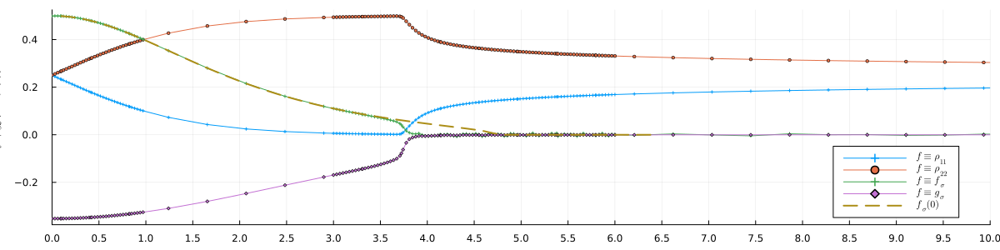

In [280]:
p2 = plot(Ux, real(df_Vin.rho11_lim), xlabel=L"U", ylabel=L"\lim_{t \to \infty} \langle \mathrm{Re}\, f(t) \rangle",legend=:bottomright, markershape=:auto, label=L"f \equiv \rho_{11}", markersize=2, xlims=(0.0,10.0),  xticks=0:0.5:12)
plot!(Ux, real(df_Vin.rho22_lim), label=L"f \equiv \rho_{22}",  markershape=:auto, markersize=2)
plot!(Ux, real(df_Vin.f_up_lim), label=L"f \equiv f_{\sigma}",  markershape=:auto, markersize=2)
plot!(Ux, real(df_Vin.C01_lim), label=L"f \equiv g_{\sigma}",  markershape=:auto, markersize=2)
plot!(lim_eq[:,1], lim_eq[:,2], label=L"f_\sigma(0)", lw=2, ls=:dash, size=(1200,300))

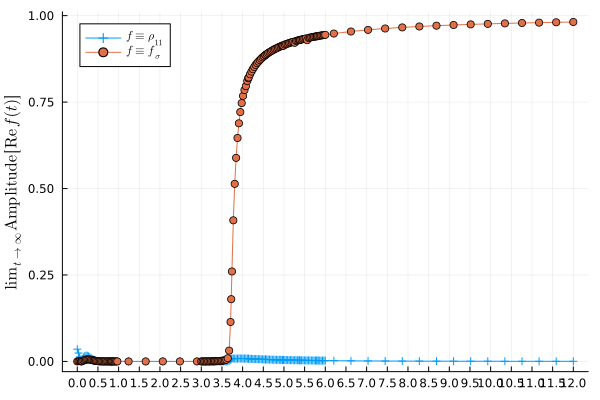

In [262]:
p8 = plot(Ux, df_Vin.rho11_ampl_asym, markershape=:auto, ylabel=L"\lim_{t \to \infty} \mathrm{Amplitude}\, [\mathrm{Re}\, f(t)]", xticks=0:0.5:12, 
        label=L"f \equiv \rho_{11}")
plot!(Ux, df_Vin.f_up_ampl_asym, markershape=:auto, label=L"f \equiv f_{\sigma}")

In [62]:
df_Vin.U[25:28]

4-element Vector{Float64}:
 3.471910112359551
 3.5056179775280905
 3.539325842696629
 3.573033707865168

In [63]:

df_Vin.f_up_lim[26]

0.07005057029144476 + 2.521771571459028e-15im

## Fourier Analysis

Extract:
- Frequencies omega_i, number of frequencies
- Amplitude A(t) (power spectrum?)
- phase phi_i

In [34]:
using FourierAnalysis
Upt = 2.6
Up, ii= findmin(abs.(df_Vin.U .- Upt))
freq_cut = 1.5

r11_i = (df_Vin[ii,:rho11])
rho11_lim = (df_Vin[ii,:rho11_lim])
r12_i = (df_Vin[ii,:rho12])
rho12_lim = (df_Vin[ii,:rho12_lim])
fs_i = (df_Vin[ii,:f_up])
f_lim = (df_Vin[ii,:f_up_lim])
gs_i = (df_Vin[ii,:C01])
g_lim = (df_Vin[ii,:C01_lim])
tx = df_Vin[ii,:t]
U_i = df_Vin[ii, :U]

slice = 1:length(r11_i)
tx_fft = tx[slice]
r11_fft = FourierAnalysis.fft(r11_i[slice] .- rho11_lim)[1:end] ./ length(slice)  |> FourierAnalysis.fftshift
r12_fft = FourierAnalysis.fft(r12_i[slice] .- rho12_lim)[1:end] ./ length(slice)  |> FourierAnalysis.fftshift
r11_fft_full = FourierAnalysis.fft(r11_i[slice])[1:end] ./ length(slice)  |> FourierAnalysis.fftshift
freqs = FourierAnalysis.fftfreq(length(tx_fft), 1.0/diff(tx_fft)[1]) |> FourierAnalysis.fftshift


fs_fft = FourierAnalysis.fft(fs_i[slice] .- f_lim)[1:end] ./ length(slice)  |> FourierAnalysis.fftshift
gs_fft = FourierAnalysis.fft(gs_i[slice] .- g_lim)[1:end] ./ length(slice)  |> FourierAnalysis.fftshift


freqs = FourierAnalysis.fftfreq(length(tx_fft), 1.0/diff(tx_fft)[1]) |> FourierAnalysis.fftshift
spectrums_rho11_zm = log.(abs.(hcat(df_Vin.rho11_fft_zm...)))
spectrums_rho12_zm = log.(abs.(hcat(df_Vin.rho12_fft_zm...)))
spectrums_f_zm = log.(abs.(hcat(df_Vin.f_up_fft_zm...)))
spectrums_g_zm = log.(abs.(hcat(df_Vin.C01_fft_zm...)))
spectrums_rho11 = log.(abs.(hcat(df_Vin.rho11_fft...)))
spectrums_rho12 = log.(abs.(hcat(df_Vin.rho12_fft...)))
spectrums_f = log.(abs.(hcat(df_Vin.f_up_fft...)))
spectrums_g = log.(abs.(hcat(df_Vin.C01_fft...)));

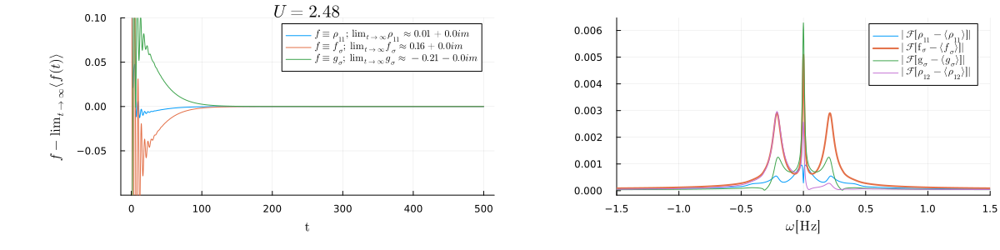

In [35]:
p1 = plot(tx, real(r11_i .- rho11_lim), ylims=(-0.1,0.1),
        title=L"U=%$(round(U_i,digits=2))", xlabel=L"\mathrm{t}", ylabel=L"f - \lim_{t \to \infty} \langle f(t) \rangle", label=L"f \equiv \rho_{11};\, \lim_{t\to\infty} \rho_{11}  \approx %$(round(rho11_lim,digits=2))")
#vline!([tx[first(slice)]], color=:orange, label="FT start")
plot!(tx, real(fs_i .- f_lim), label=L"f \equiv f_\sigma;\; \lim_{t\to\infty} f_\sigma \approx %$(round(f_lim,digits=2))")
plot!(tx, real(gs_i .- g_lim), label=L"f \equiv g_\sigma;\; \lim_{t\to\infty} g_\sigma \approx %$(round(g_lim,digits=2))")
p2 = plot(freqs, abs.(r11_fft), xlabel=L"\omega [\mathrm{Hz}]", label=L" | \mathcal{F}[\mathrm{\rho_{11}} - \langle \rho_{11} \rangle] |", xlims=(-freq_cut,freq_cut))
plot!(freqs, abs.(fs_fft), label=L"| \mathcal{F}[\mathrm{f_\sigma} - \langle f_\sigma \rangle] |", xlims=(-freq_cut,freq_cut), lw=2)
plot!(freqs, abs.(gs_fft), label=L"| \mathcal{F}[\mathrm{g_\sigma}  - \langle g_\sigma \rangle] |", xlims=(-freq_cut,freq_cut))
plot!(freqs, abs.(r12_fft), label=L"|\mathcal{F}[\mathrm{\rho_{12}} - \langle \rho_{12} \rangle]  |", xlims=(-freq_cut,freq_cut))

l = @layout [
    a{0.5w} b{0.5w}
    ]
p = plot(p1, p2,  layout=l,size=(1200,300), left_margin=20mm, bottom_margin=10mm)
display(p)

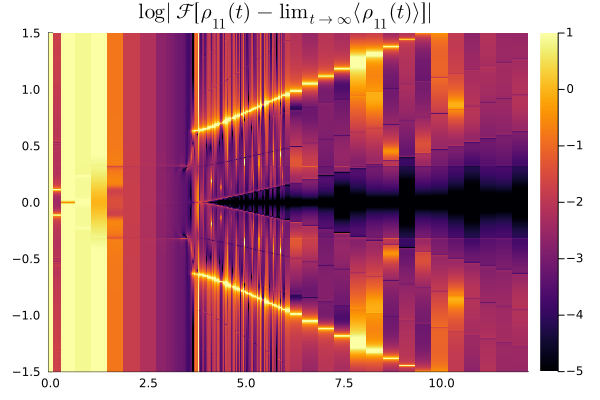

In [36]:

    p7 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho11 .- spectrums_g,clims=(-5,1), ylims=(-freq_cut,freq_cut),       title=L"\log \,|\mathcal{F}[\rho_{11}(t) - \lim_{t \to \infty} \langle \rho_{11}(t) \rangle]|")

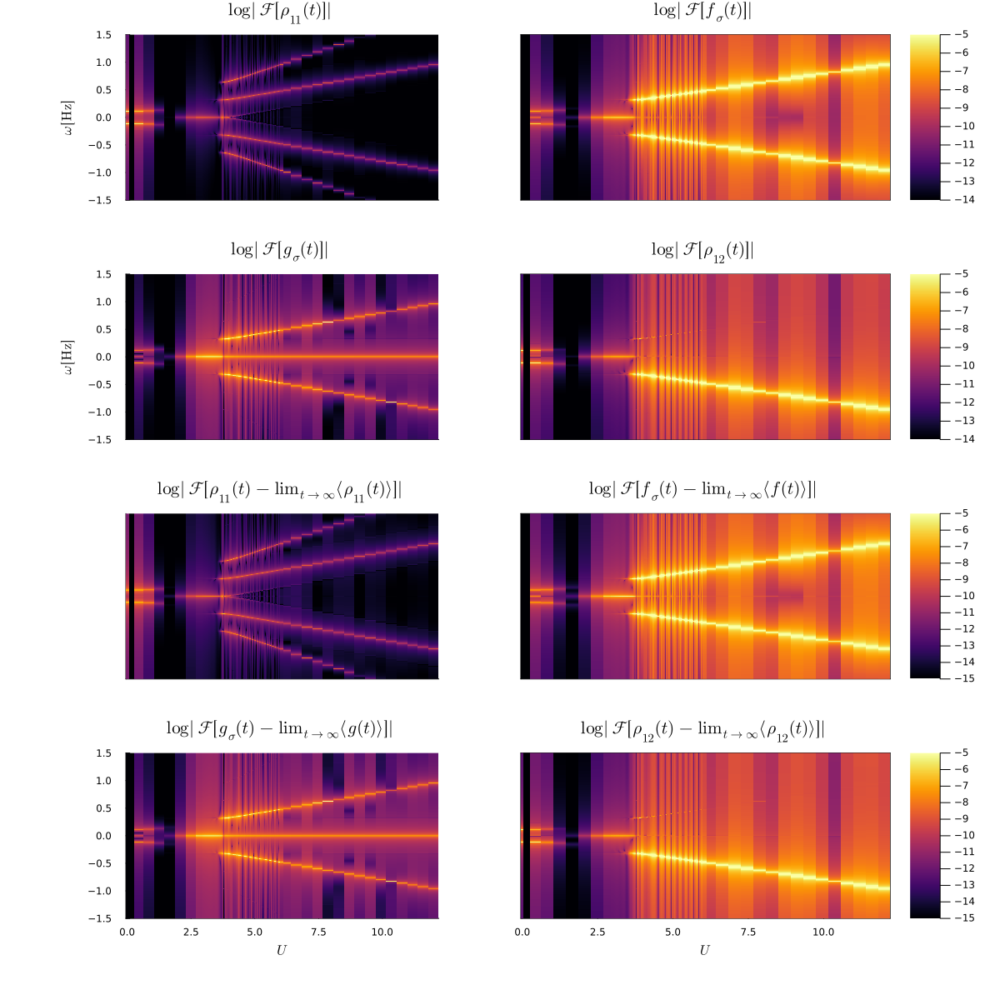

In [37]:
p3 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho11_zm,clims=(-14,-5), ylims=(-freq_cut,freq_cut), ylabel=L"\omega [\mathrm{Hz}]", title=L"\log \,|\mathcal{F}[\rho_{11}(t)]|",legend=nothing, xticks=nothing, bottom_margin=-5mm, right_margin=-5mm)
p4 = heatmap(Ux,df_Vin[1,:freqs],spectrums_f_zm,clims=(-14,-5), ylims=(-freq_cut,freq_cut),  title=L"\log \,|\mathcal{F}[f_\sigma(t)]|", framestyle=:box, xticks=nothing, yticks=nothing)
p5 = heatmap(Ux,df_Vin[1,:freqs],spectrums_g_zm,clims=(-14,-5), ylims=(-freq_cut,freq_cut), ylabel=L"\omega [\mathrm{Hz}]", title=L"\log \,|\mathcal{F}[g_\sigma(t)]|",legend=nothing, xticks=nothing)
p6 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho12_zm,clims=(-14,-5), ylims=(-freq_cut,freq_cut),   title=L"\log \,|\mathcal{F}[\rho_{12}(t)]|", framestyle=:box, xticks=nothing, yticks=nothing)
p7 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho11,clims=(-15,-5), ylims=(-freq_cut,freq_cut),       title=L"\log \,|\mathcal{F}[\rho_{11}(t) - \lim_{t \to \infty} \langle \rho_{11}(t) \rangle]|",legend=nothing, xticks=nothing, yticks=nothing)
p8 = heatmap(Ux,df_Vin[1,:freqs],spectrums_f,clims=(-15,-5), ylims=(-freq_cut,freq_cut),         title=L"\log \,|\mathcal{F}[f_\sigma(t) - \lim_{t \to \infty} \langle f(t) \rangle]|", framestyle=:box, xticks=nothing, yticks=nothing)
p9 = heatmap(Ux,df_Vin[1,:freqs],spectrums_g,clims=(-15,-5), ylims=(-freq_cut,freq_cut), xlabel=L"U",  title=L"\log \,|\mathcal{F}[g_\sigma(t) - \lim_{t \to \infty} \langle g(t) \rangle]|",legend=nothing)
p10 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho12,clims=(-15,-5), ylims=(-freq_cut,freq_cut), xlabel=L"U",  title=L"\log \,|\mathcal{F}[\rho_{12}(t) - \lim_{t \to \infty} \langle \rho_{12}(t) \rangle]|", framestyle=:box, yticks=nothing)

l = @layout [
    c{0.4w} d{0.6w} 
    e{0.4w} f{0.6w} 
    g{0.4w} h{0.6w}
    l{0.4w} j{0.6w}
    ]
p = plot( p3, p4, p5, p6, p7, p8, p9, p10, layout=l,size=(1200,1200), left_margin=20mm, bottom_margin=10mm)
savefig("fourier.pdf")
display(p)

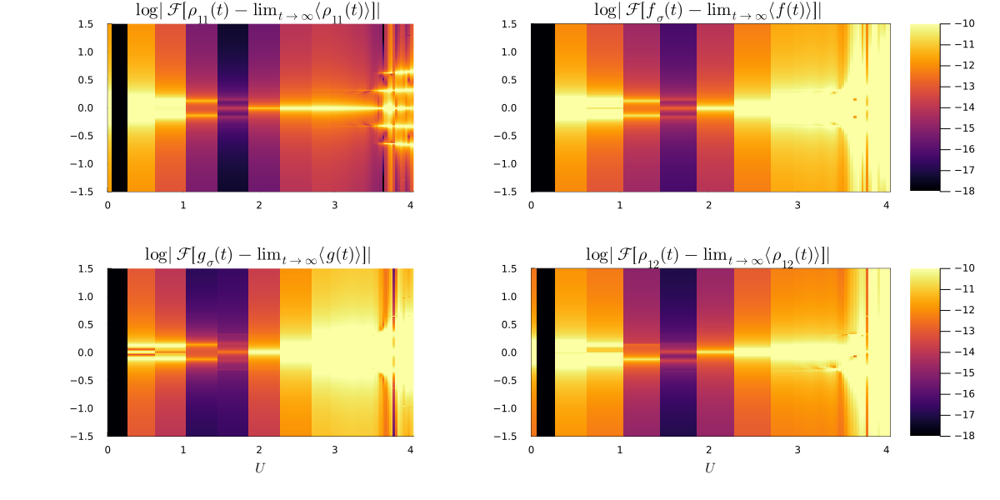

In [38]:
p7 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho11,clims=(-18,-10), ylims=(-freq_cut,freq_cut), xlims=(0,1.1*U_c), title=L"\log \,|\mathcal{F}[\rho_{11}(t) - \lim_{t \to \infty} \langle \rho_{11}(t) \rangle]|",legend=nothing,)
p8 = heatmap(Ux,df_Vin[1,:freqs],spectrums_f,clims=(-18,-10), ylims=(-freq_cut,freq_cut), xlims=(0,1.1*U_c),         title=L"\log \,|\mathcal{F}[f_\sigma(t) - \lim_{t \to \infty} \langle f(t) \rangle]|", framestyle=:box,)
p9 = heatmap(Ux,df_Vin[1,:freqs],spectrums_g,clims=(-18,-10), ylims=(-freq_cut,freq_cut), xlims=(0,1.1*U_c), xlabel=L"U",  title=L"\log \,|\mathcal{F}[g_\sigma(t) - \lim_{t \to \infty} \langle g(t) \rangle]|",legend=nothing)
p10 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho12,clims=(-18,-10), ylims=(-freq_cut,freq_cut), xlims=(0,1.1*U_c), xlabel=L"U",  title=L"\log \,|\mathcal{F}[\rho_{12}(t) - \lim_{t \to \infty} \langle \rho_{12}(t) \rangle]|", framestyle=:box)

l = @layout [ 
    g{0.4w} h{0.6w}
    l{0.4w} j{0.6w}
    ]
p = plot(p7, p8, p9, p10, layout=l,size=(1200,600), left_margin=20mm, bottom_margin=10mm)
display(p)

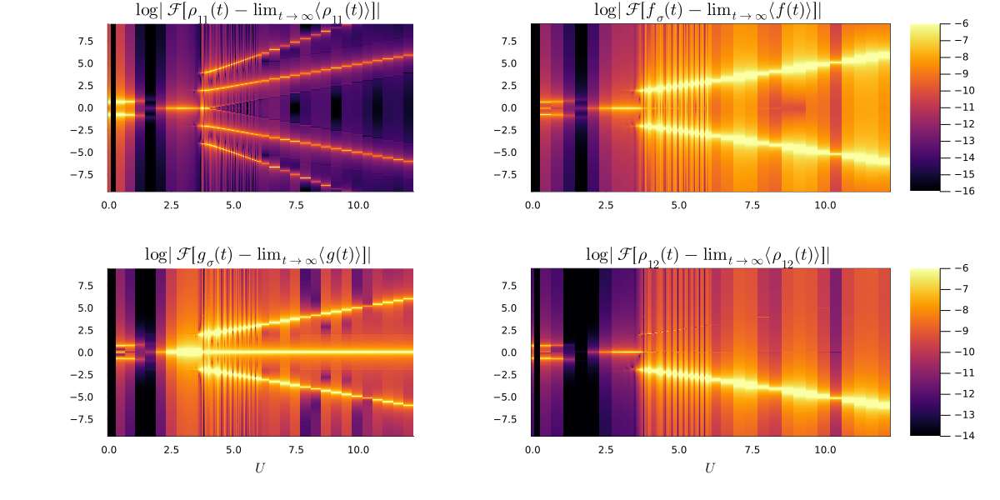

In [39]:
p7 = heatmap(Ux,2π .* df_Vin[1,:freqs],spectrums_rho11,clims=(-16,-8), ylims=2π .*(-freq_cut,freq_cut),       title=L"\log \,|\mathcal{F}[\rho_{11}(t) - \lim_{t \to \infty} \langle \rho_{11}(t) \rangle]|",legend=nothing,)
p8 = heatmap(Ux,2π .* df_Vin[1,:freqs],spectrums_f,clims=(-16,-6), ylims=2π .*(-freq_cut,freq_cut),         title=L"\log \,|\mathcal{F}[f_\sigma(t) - \lim_{t \to \infty} \langle f(t) \rangle]|", framestyle=:box,)
p9 = heatmap(Ux,2π .* df_Vin[1,:freqs],spectrums_g,clims=(-16,-8), ylims=2π .*(-freq_cut,freq_cut), xlabel=L"U",  title=L"\log \,|\mathcal{F}[g_\sigma(t) - \lim_{t \to \infty} \langle g(t) \rangle]|",legend=nothing)
p10 = heatmap(Ux,2π .* df_Vin[1,:freqs],spectrums_rho12,clims=(-14,-6), ylims=2π .*(-freq_cut,freq_cut), xlabel=L"U",  title=L"\log \,|\mathcal{F}[\rho_{12}(t) - \lim_{t \to \infty} \langle \rho_{12}(t) \rangle]|", framestyle=:box)

l = @layout [ 
    g{0.4w} h{0.6w}
    l{0.4w} j{0.6w}
    ]
p = plot(p7, p8, p9, p10, layout=l,size=(1200,600), left_margin=20mm, bottom_margin=10mm)
display(p)

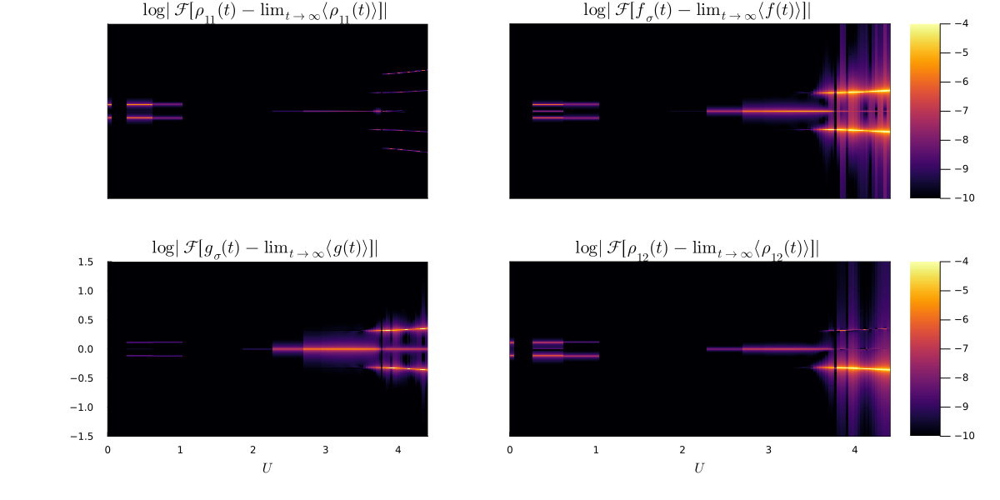

In [40]:
p7 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho11,clims=(-10,-4), ylims=(-freq_cut,freq_cut), xlims=(0,1.2 * U_c),       title=L"\log \,|\mathcal{F}[\rho_{11}(t) - \lim_{t \to \infty} \langle \rho_{11}(t) \rangle]|",legend=nothing, xticks=nothing, yticks=nothing)
p8 = heatmap(Ux,df_Vin[1,:freqs],spectrums_f,clims=(-10,-4), ylims=(-freq_cut,freq_cut), xlims=(0,1.2 * U_c),         title=L"\log \,|\mathcal{F}[f_\sigma(t) - \lim_{t \to \infty} \langle f(t) \rangle]|", framestyle=:box, xticks=nothing, yticks=nothing)
p9 = heatmap(Ux,df_Vin[1,:freqs],spectrums_g,clims=(-10,-4), ylims=(-freq_cut,freq_cut), xlims=(0,1.2 * U_c), xlabel=L"U",  title=L"\log \,|\mathcal{F}[g_\sigma(t) - \lim_{t \to \infty} \langle g(t) \rangle]|",legend=nothing)
p10 = heatmap(Ux,df_Vin[1,:freqs],spectrums_rho12,clims=(-10,-4), ylims=(-freq_cut,freq_cut), xlims=(0,1.2 * U_c), xlabel=L"U",  title=L"\log \,|\mathcal{F}[\rho_{12}(t) - \lim_{t \to \infty} \langle \rho_{12}(t) \rangle]|", framestyle=:box, yticks=nothing)

l = @layout [
    g{0.4w} h{0.6w}
    l{0.4w} j{0.6w}
    ]
p = plot(  p7, p8, p9, p10, layout=l,size=(1200,600), left_margin=20mm, bottom_margin=10mm)
#savefig("fourier2.pdf")
display(p)

1.6551724137931034


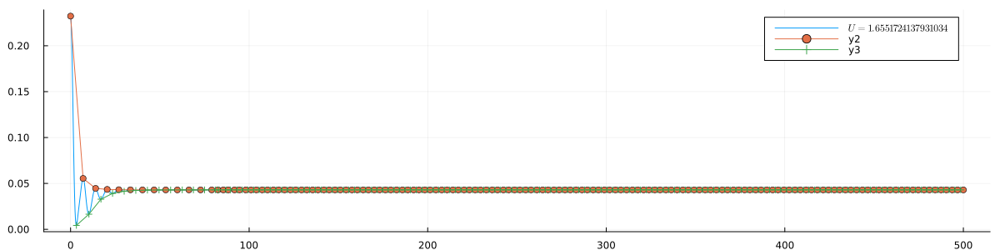

In [49]:
#y=analyticsignal(r11_0)
using Images

Upt = 1.8
Up, ii= findmin(abs.(df_Vin.U .- Upt))

println(Ux[ii])
r11_0 = real(df_Vin[df_Vin.U .≈ Ux[ii], :rho11][1])
tx = df_Vin[ii,:t]
maxy_ix = findlocalmaxima(r11_0)[1:end]
miny_ix = findlocalminima(r11_0)
plot(tx, r11_0, label=L"U=%$(Ux[ii])", size=(1200,300))
plot!(tx[maxy_ix],r11_0[maxy_ix],markershape=:auto)
plot!(tx[miny_ix],r11_0[miny_ix],markershape=:auto)


[4.825664520757833e-10, 4.294242045288499e-10, 3.7557809640098583e-10]
[4.825664520757833e-10, 4.294242045288499e-10, 3.7557809640098583e-10]


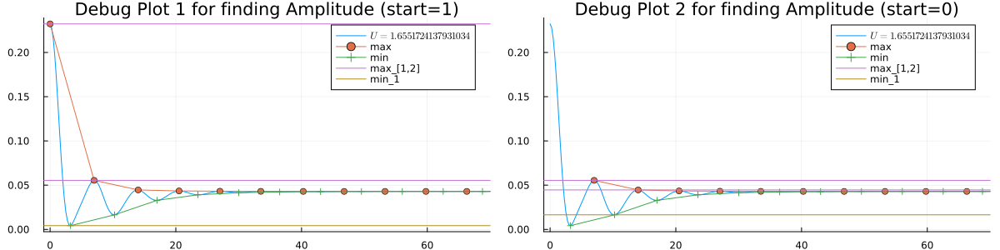

In [92]:
maxy_ix_test = findlocalmaxima(r11_0)[1:end]
miny_ix_test = findlocalminima(r11_0)
start = tx[miny_ix_test[1]] <  tx[maxy_ix_test[1]] ? 0 : 1
ind = 2:length(maxy_ix_test)-2
ampl = Vector{Float64}(undef, length(ind))
t_ampl = tx[miny_ix_test[ind]]
ii_test = 0
for (i,ii) in enumerate(ind)
    i == 1 && (ii_test = ii)
    ampl[i] = mean(r11_0[maxy_ix_test[ii-1:ii]]) - r11_0[miny_ix_test[ii-start]]
end
println(ampl[end-2:end])
ii = ii_test
p1 = plot(tx, r11_0, label=L"U=%$(Ux[Ui])", size=(1200,300), xlims=(-1,70), title="Debug Plot 1 for finding Amplitude (start=$start)")
plot!(tx[maxy_ix_test],r11_0[maxy_ix_test],markershape=:auto, label="max")
plot!(tx[miny_ix_test],r11_0[miny_ix_test],markershape=:auto, label="min")
hline!(r11_0[maxy_ix_test[ii-1:ii]], label="max_[1,2]")
hline!([r11_0[miny_ix_test[ii-start]]],label="min_1")

maxy_ix_test = findlocalmaxima(r11_0)[2:end]
miny_ix_test = findlocalminima(r11_0)
start = tx[miny_ix_test[1]] <  tx[maxy_ix_test[1]] ? 0 : 1
ind = 2:length(maxy_ix_test)-2
ampl = Vector{Float64}(undef, length(ind))
t_ampl = tx[miny_ix_test[ind]]
ii_test = 0
for (i,ii) in enumerate(ind)
    i == 1 && (ii_test = ii)
    ampl[i] = mean(r11_0[maxy_ix_test[ii-1:ii]]) - r11_0[miny_ix_test[ii]]
end
println(ampl[end-2:end])
ii = ii_test
p2 = plot(tx, r11_0, label=L"U=%$(Ux[Ui])", size=(1200,300), xlims=(-1,70), title="Debug Plot 2 for finding Amplitude (start=$start)")
plot!(tx[maxy_ix_test],r11_0[maxy_ix_test],markershape=:auto, label="max")
plot!(tx[miny_ix_test],r11_0[miny_ix_test],markershape=:auto, label="min")
hline!(r11_0[maxy_ix_test[ii-1:ii]], label="max_[1,2]")
hline!([r11_0[miny_ix_test[ii]]],label="min_1")

plot(p1,p2, size=(1200,300))

2.0689655172413794


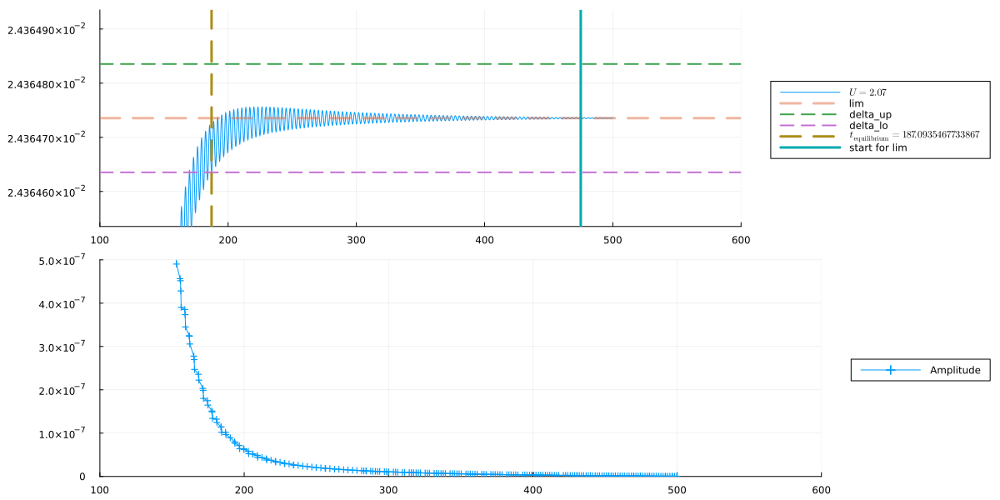

In [235]:
function find_ampl_lim_max(tx::AbstractVector, signal::AbstractVector, lim::Float64)
    max_list = Float64[abs(last(signal) - lim)]
    max_tx_list = Float64[last(tx)]
    
    for i in length(signal)-1:-1:1
        ampl_new = abs(signal[i] - lim)
        #println(ampl_new, " vs ", last(max_list))
        if  ampl_new > last(max_list)
            push!(max_list, ampl_new)
            push!(max_tx_list, tx[i])
        end
    end
    return max_tx_list, max_list
end

function eq_time_old(tx, signal; delta=1e-7, lim_tx_start=450.0)
    maxy_ix = findlocalmaxima(signal)
    miny_ix = findlocalminima(signal)
    lim = find_lim(tx, signal, lim_tx_start=lim_tx_start)
    if length(maxy_ix) != 0
        start = tx[miny_ix[1]] <  tx[maxy_ix[1]] ? 0 : 1
        ind = 2:length(maxy_ix)-2
        for (i,ii) in enumerate(ind)
            if abs(mean(signal[maxy_ix[ii-1:ii]]) - lim) < delta && abs(signal[miny_ix[ii-start]] - lim) < delta
                return tx[miny_ix[ii-start]]
            end
        end
    end
    return tx[end]
end

function eq_time(tx, signal; delta=1e-7, lim_tx_start=450.0)
    lim = find_lim(tx, signal)
    tx_ampl, lim_ampl = find_ampl_lim_max(tx, signal, lim)
    res_i = searchsortedfirst(lim_ampl, 1e-7)
    res =  res_i > length(tx_ampl) ? tx[end] : tx_ampl[res_i]
    return res
end


delta=1e-7
Upt = 2.0689655172413794
Up, ii= findmin(abs.(df_Vin.U .- Upt))
println(Ux[ii])
r11_0 = real(df_Vin[df_Vin.U .≈ Ux[ii], :rho11][1])
tx = df_Vin[ii,:t]

lim_ind=length(r11_0)-100
lim = mean(r11_0[lim_ind:end])
tx_lims, r11_ampl = find_ampl_lim_max(tx, r11_0, lim)
eq_tx = eq_time(tx, r11_0, delta=delta)

p1 = plot(tx, r11_0, label=L"U=%$(round(Ux[ii],digits=2))", size=(1200,300),xlims=(100,600), ylims=(lim-2*delta, lim+2*delta), legend=:outerright)
hline!([lim], label="lim", lw=3, ls=:dash, alpha=0.5)
hline!([lim+delta], label="delta_up", lw=2, ls=:dash)
hline!([lim-delta], label="delta_lo", lw=2, ls=:dash)
vline!([eq_tx], label=L"t_\mathrm{equilibrium} = %$(eq_tx)", lw=3, ls=:dash)
vline!([tx[lim_ind]] , label="start for lim", lw=3)

p2 = plot(tx_lims, r11_ampl, markershape=:auto,  xlims=(100,600), ylims=(0,5*delta), label="Amplitude", legend=:outerright)
plot(p1, p2, size=(1200,600), layout=(2,1))

In [193]:
r11_ampl

1456-element Vector{Float64}:
 4.0350746242576174e-9
 5.784409902453991e-9
 1.3925736316693083e-8
 2.15397199269593e-8
 2.663137252997133e-8
 2.781352964782713e-8
 2.90523327495934e-8
 3.460804176395882e-8
 3.769985472672904e-8
 4.0288818931207004e-8
 4.7100431592277114e-8
 4.753619961377076e-8
 5.671873054037546e-8
 ⋮
 0.02943050316921733
 0.044268445947509616
 0.05920897860452331
 0.07089096883126819
 0.07764275629883449
 0.0799653277280663
 0.09171383203358432
 0.12639797877618594
 0.1634786609149048
 0.19611078132458112
 0.21831923319474336
 0.22617311955878228

In [196]:
r11_

21

In [198]:
res_i > length(r11_ampl)

false

In [214]:
signal = r11_0
lim = find_lim(tx, signal)
tx_ampl, lim_ampl = find_ampl_lim_max(tx, signal, lim)
res_i = searchsortedfirst(lim_ampl, 1e-7)
res =  res_i > length(tx_ampl) ? tx[end] : tx_ampl[res_i]

451.7258629314657

In [212]:
lim

NaN

In [210]:
tx_ampl

1-element Vector{Float64}:
 500.0

In [208]:
lim_ampl

1-element Vector{Float64}:
 NaN

5.8988764044943816


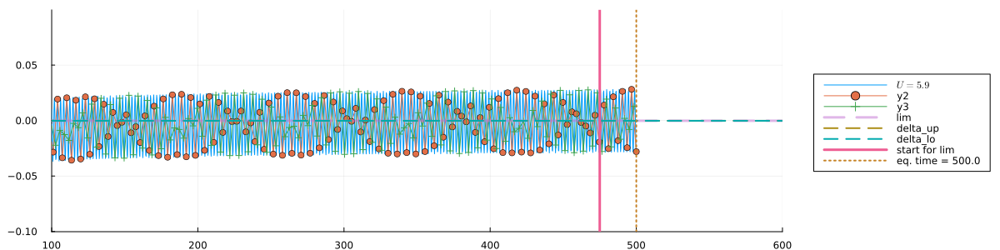

In [245]:
Upt = 5.9
Up, ii= findmin(abs.(df_Vin.U .- Upt))
println(Ux[ii])
r11_0 = real(df_Vin[df_Vin.U .≈ Ux[ii], :C01][1])
tx = df_Vin[ii,:t]
lim_ind=length(r11_0)-100
lim = mean(r11_0[lim_ind:end])
delta=1e-7
eq_tx = eq_time(tx, r11_0; delta=1e-7, lim_tx_start=450.0)
plot(tx, r11_0, label=L"U=%$(round(Ux[ii],digits=2))", size=(1200,300),xlims=(100,600), ylims=(lim-0.1, lim+0.1), legend=:outerright)
plot!(tx[maxy_ix],r11_0[maxy_ix],markershape=:auto)
plot!(tx[miny_ix],r11_0[miny_ix],markershape=:auto)
hline!([lim], label="lim", lw=3, ls=:dash, alpha=0.5)
hline!([lim+delta], label="delta_up", lw=2, ls=:dash)
hline!([lim-delta], label="delta_lo", lw=2, ls=:dash)
vline!([tx[lim_ind]] , label="start for lim", lw=3)
vline!([eq_tx], label="eq. time = $(round(eq_tx,digits=2))", lw=2, ls=:dot)

In [154]:
eq_tx

6.003001500750375

In [125]:
searchsortedfirst(tx, 400.0)

1601

In [127]:
length(tx)

2000

In [129]:
length(r11_0)

2000

# Effects of V

- V -> oo : higher frequency
- V > V_C : more than one frequency

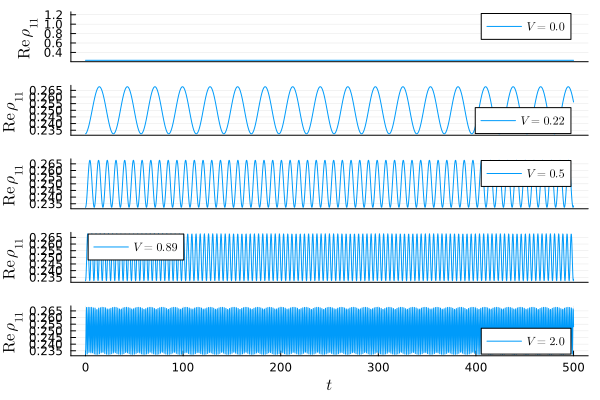

In [18]:
tt = df[df.U .≈ 0.0 .&& df.V .≈ 0.0,:]
p1 = plot(tt.t, real(tt.rho11), xaxis=nothing, ylabel=L"\mathrm{Re}\,\rho_{11}", label=L"V=%$0.0")
tt = df[df.U .≈ 0.0 .&& df.V .≈ VList[2],:]
p2 = plot(tt.t, real(tt.rho11), xaxis=nothing, ylabel=L"\mathrm{Re}\,\rho_{11}", label=L"V=%$(round(VList[2],digits=2))")
tt = df[df.U .≈ 0.0 .&& df.V .≈ 0.5,:]
p3 = plot(tt.t, real(tt.rho11), xaxis=nothing, ylabel=L"\mathrm{Re}\,\rho_{11}", label=L"V=%$(round(0.5,digits=2))")
tt = df[df.U .≈ 0.0 .&& df.V .≈ VList[6],:]
p4 = plot(tt.t, real(tt.rho11), xaxis=nothing, ylabel=L"\mathrm{Re}\,\rho_{11}", label=L"V=%$(round(VList[6],digits=2))")
tt = df[df.U .≈ 0.0 .&& df.V .≈ VList[end],:]
p5 = plot(tt.t, real(tt.rho11), xlabel=L"t", ylabel=L"\mathrm{Re}\,\rho_{11}", label=L"V=%$(round(VList[end],digits=2))")

plot(p1,p2,p3,p4,p5, layout=(5,1))